In [1]:
import sys
sys.path = [p for p in sys.path if "ParaView" not in p]


import torch as pt
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import matplotlib.tri as mtri
from flowtorch import DATASETS
from flowtorch.data import FOAMDataloader, mask_box
from pydmd import DMD, ParametricDMD
from ezyrb import POD, RBF
from pathlib import Path
import re
# For High Quality Visuals
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 160  # crisp visuals


Refer to the installation instructions at https://github.com/FlowModelingControl/flowtorch
If you are not using the TecplotDataloader, ignore this warning.


In [2]:
# Parameters
Re_list = [200, 400, 600, 800]  # Reynolds numbers


In [3]:
# Load and prepare data

# Reynolds numbers
Re_list = [200, 400, 600, 800]

# Construct full folder paths
base_path = Path("~/OpenFOAM/run").expanduser()
Re_folders = [base_path / f"cylinder_2D_Re{Re}" for Re in Re_list]

print("Detected Reynolds numbers:", Re_list)

# Sampling step for downsampling the snapshots
sampling_step = 5

# Dictionary to hold all snapshot matrices
snapshot_dict = {}

# Function to load and mask velocity snapshots
def load_masked_matrix(loader, mask, times):
    num_points = mask.sum().item()
    num_times = len(times)
    data_matrix = pt.zeros((2 * num_points, num_times), dtype=pt.float64)

    for i, time in enumerate(times):
        snapshot = loader.load_snapshot("U", time)
        ux_masked = pt.masked_select(snapshot[:, 0], mask)
        uy_masked = pt.masked_select(snapshot[:, 1], mask)
        data_matrix[:num_points, i] = ux_masked
        data_matrix[num_points:, i] = uy_masked

    return data_matrix.numpy(), num_points

# Loop through folders and load data
for folder, Re in zip(Re_folders, Re_list):
    path = str(folder)
    loader = FOAMDataloader(path)
    times = loader.write_times

    # Filter and downsample time steps
    window_times = [t for t in times if 1.0 <= float(t) <= 5.0]
    sampled_times = window_times[::sampling_step]

    # Create cylinder region mask
    vertices = loader.vertices[:, :2]
    mask = mask_box(vertices, lower=[0.1, -1], upper=[0.75, 1])

    # Load and store velocity snapshots
    data_matrix, num_points = load_masked_matrix(loader, mask, sampled_times)
    snapshot_dict[Re] = data_matrix




INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor0/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor1/constant


Detected Reynolds numbers: [200, 400, 600, 800]


INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor0/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor1/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor0/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor1/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor0/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor1/constant


In [4]:
# Print the loaded data matrix shape for each Reynolds number
print("Data_matrix shape for each Re:",data_matrix.shape)

Data_matrix shape for each Re: (11492, 401)


## Offline Phase: POD & DMD

In [5]:
# Step 1: Perform POD on concatenated snapshot data

# Stack all snapshot matrices across Reynolds numbers
all_data = np.hstack([snapshot_dict[Re] for Re in Re_list])  # shape: (2*num_points, total_time)

# Compute POD basis
pod = POD(rank=21)  # Capture 99 percent of energy
pod.fit(all_data)

# Project each snapshot matrix into reduced space
reduced_snapshots = {Re: pod.transform(snapshot_dict[Re]) for Re in Re_list}

# Print shape to verify
for Re in Re_list:
    print(f"Re = {Re}, Reduced shape = {reduced_snapshots[Re].shape}")


Re = 200, Reduced shape = (21, 401)
Re = 400, Reduced shape = (21, 401)
Re = 600, Reduced shape = (21, 401)
Re = 800, Reduced shape = (21, 401)


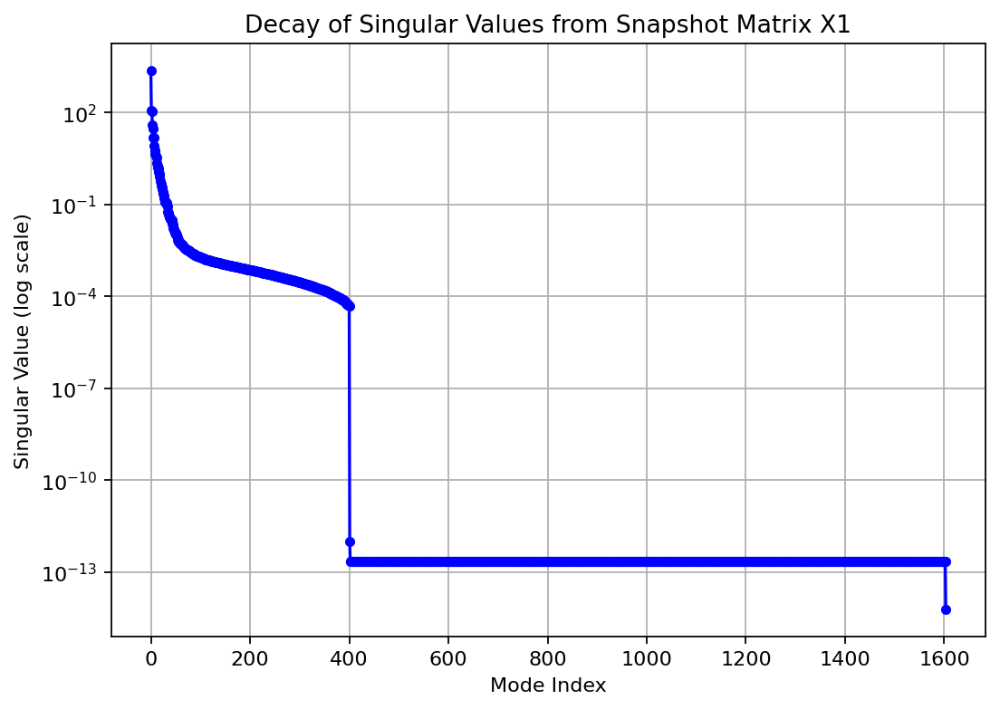

In [6]:
# Singular value decay plot for the snapshot matrix X1


U, S, Vh = np.linalg.svd(all_data, full_matrices=False)

plt.figure(figsize=(7, 5))
plt.semilogy(S, 'bo-', markersize=4)
plt.title("Decay of Singular Values from Snapshot Matrix X1")
plt.xlabel("Mode Index")
plt.ylabel("Singular Value (log scale)")
plt.grid(True)
plt.tight_layout()
plt.show()

In [7]:
# Step 2: Partitioned DMD on reduced snapshots

# Dictionary to store DMD models per Reynolds number
dmd_models = {}

# Apply DMD separately for each Reynolds number
for Re in Re_list:
    snapshot = reduced_snapshots[Re]  # shape: (r, N)
    dmd = DMD(svd_rank=21)
    dmd.fit(snapshot)
    dmd_models[Re] = dmd

    print(f"DMD model for Re={Re} fitted. Modes shape: {dmd.modes.shape}, Eigenvalues count: {len(dmd.eigs)}")



INFO:root:Snapshots: (21, 401), snapshot shape: (21,)
INFO:root:Snapshots: (21, 401), snapshot shape: (21,)
INFO:root:Snapshots: (21, 401), snapshot shape: (21,)
INFO:root:Snapshots: (21, 401), snapshot shape: (21,)


DMD model for Re=200 fitted. Modes shape: (21, 21), Eigenvalues count: 21
DMD model for Re=400 fitted. Modes shape: (21, 21), Eigenvalues count: 21
DMD model for Re=600 fitted. Modes shape: (21, 21), Eigenvalues count: 21
DMD model for Re=800 fitted. Modes shape: (21, 21), Eigenvalues count: 21


In [8]:
# Step 3: Stabilize each DMD model separately
stabilized_models = {}

for Re in Re_list:
    dmd = dmd_models[Re]
    Phi = dmd.modes
    Lambda = dmd.eigs
    b = dmd.amplitudes

    # Stabilization: retain only eigenvalues near unit circle
    epsilon = 1e-2  # tolerance for marginal stability
    stable_indices = np.where(np.abs(np.abs(Lambda) - 1) < epsilon)[0]

    # Normalize eigenvalues to unit circle
    Lambda_stable = Lambda[stable_indices] / np.abs(Lambda[stable_indices])
    Phi_stable = Phi[:, stable_indices]
    b_stable = b[stable_indices]

    # Store stabilized components
    stabilized_models[Re] = (Phi_stable, Lambda_stable, b_stable)



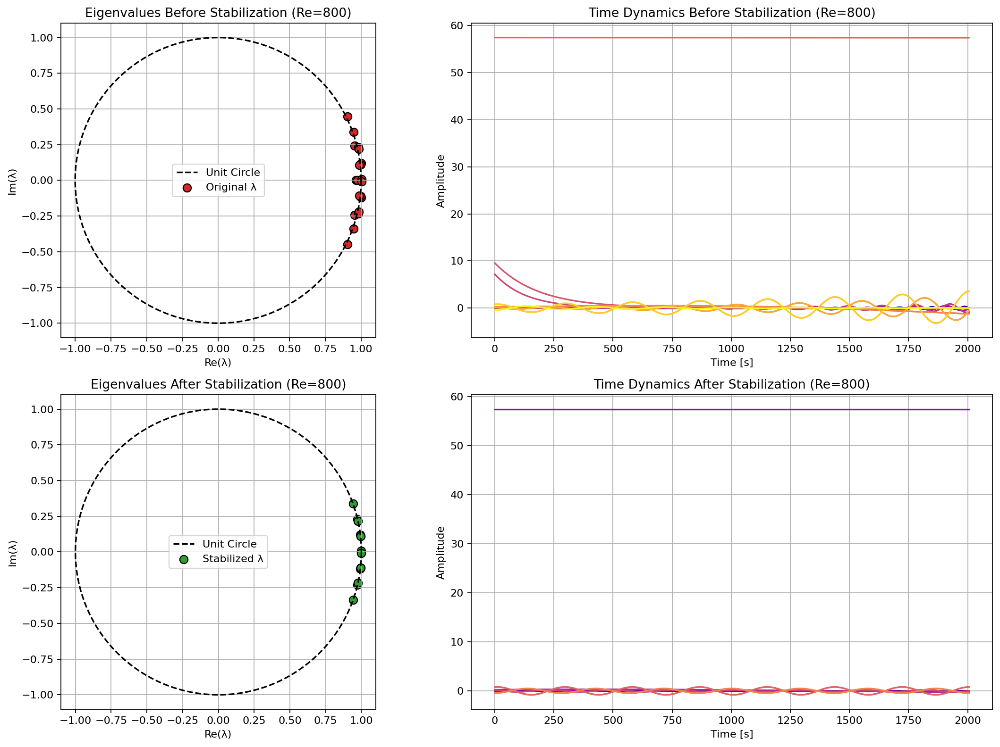

In [9]:
# Eigenvalue & Time‐Dynamics before and after stabilization plot

# Choose a Reynolds number to visualize
Re_target = Re_list[3]  # or any specific Re you want to plot

# Retrieve original and stabilized components
dmd = dmd_models[Re_target]
Phi_stable, Lambda_stable, b_stable = stabilized_models[Re_target]

# Original eigenvalues
eigs_original = dmd.eigs
eigs_stabilized = Lambda_stable

# Time vector
num_snapshots = dmd.dynamics.shape[1]
times_num = np.linspace(0, num_snapshots * sampling_step, num_snapshots)

# Stabilized time dynamics
stabilized_dynamics = np.array([
    b_stable[i] * Lambda_stable[i]**np.arange(num_snapshots)
    for i in range(len(Lambda_stable))
])

# Prepare unit circle
theta = np.linspace(0, 2 * np.pi, 300)
unit_circle = np.exp(1j * theta)

# Create figure
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
colors = plt.cm.plasma(np.linspace(0, 1, max(len(dmd.dynamics), len(stabilized_dynamics))))

# Top-Left: Eigenvalues BEFORE stabilization
ax = axes[0, 0]
ax.plot(unit_circle.real, unit_circle.imag, 'k--', lw=1.5, label="Unit Circle")
ax.scatter(eigs_original.real, eigs_original.imag, c='tab:red', edgecolors='black', s=60, label="Original λ")
ax.set_title(f"Eigenvalues Before Stabilization (Re={Re_target})")
ax.set_xlabel("Re(λ)")
ax.set_ylabel("Im(λ)")
ax.set_aspect('equal')
ax.grid(True)
ax.legend()

# Bottom-Left: Eigenvalues AFTER stabilization
ax = axes[1, 0]
ax.plot(unit_circle.real, unit_circle.imag, 'k--', lw=1.5, label="Unit Circle")
ax.scatter(eigs_stabilized.real, eigs_stabilized.imag, c='tab:green', edgecolors='black', s=60, label="Stabilized λ")
ax.set_title(f"Eigenvalues After Stabilization (Re={Re_target})")
ax.set_xlabel("Re(λ)")
ax.set_ylabel("Im(λ)")
ax.set_aspect('equal')
ax.grid(True)
ax.legend()

# Top-Right: Time Dynamics BEFORE stabilization
ax = axes[0, 1]
for i, dyn in enumerate(dmd.dynamics):
    ax.plot(times_num, dyn.real, lw=1.5, color=colors[i])
ax.set_title(f"Time Dynamics Before Stabilization (Re={Re_target})")
ax.set_xlabel("Time [s]")
ax.set_ylabel("Amplitude")
ax.grid(True)

# Bottom-Right: Time Dynamics AFTER stabilization
ax = axes[1, 1]
for i in range(stabilized_dynamics.shape[0]):
    ax.plot(times_num, stabilized_dynamics[i].real, lw=1.5, color=colors[i])
ax.set_title(f"Time Dynamics After Stabilization (Re={Re_target})")
ax.set_xlabel("Time [s]")
ax.set_ylabel("Amplitude")
ax.grid(True)

plt.tight_layout()
plt.show()


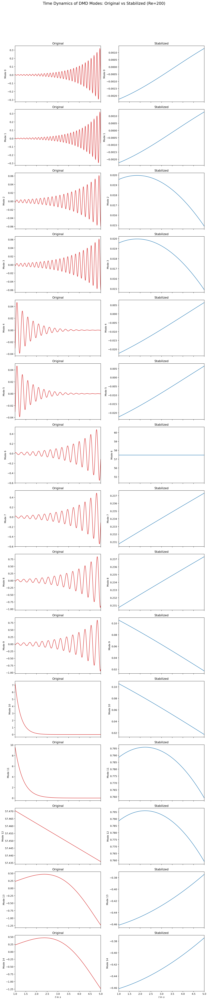

In [10]:
# Time dynamics of the retained DMD modes  Original vs stabilized

# Choose a Reynolds number to visualize
Re_input = Re_list[0]  # or any specific Re value

# Retrieve original and stabilized components
dmd = dmd_models[Re_input]
Phi_stable, Lambda_stable, b_stable = stabilized_models[Re_input]

# Convert time array
times_num = [float(t) for t in sampled_times]
t_min, t_max = min(times_num), max(times_num)
time_steps = len(times_num)

# Stabilized time dynamics
stabilized_dynamics = np.array([
    b_stable[i] * Lambda_stable[i]**np.array(times_num)
    for i in range(len(Lambda_stable))
])

# Number of modes to compare
num_modes = stabilized_dynamics.shape[0]
modes = list(range(num_modes))

# Create subplot grid: rows = modes, cols = original vs stabilized
fig, axarr = plt.subplots(num_modes, 2, figsize=(12, 4 * num_modes), sharex=True)

# Ensure axarr is always 2D
if num_modes == 1:
    axarr = np.array([axarr])

for i, m in enumerate(modes):
    # Original dynamics (if available)
    if m < len(dmd.dynamics):
        signal_orig = dmd.dynamics[m].real[:time_steps]
        axarr[i][0].plot(times_num, signal_orig, lw=1.5, color='tab:red')
    else:
        axarr[i][0].text(0.5, 0.5, "Not available", ha='center', va='center')
    axarr[i][0].set_ylabel(f"Mode {m}")
    axarr[i][0].set_title("Original")

    # Stabilized dynamics
    signal_stab = stabilized_dynamics[m].real
    axarr[i][1].plot(times_num, signal_stab, lw=1.5, color='tab:blue')
    axarr[i][1].set_title("Stabilized")
    axarr[i][1].set_ylabel(f"Mode {m}")

# Final styling
for ax in axarr[-1]:
    ax.set_xlabel(r"$t$ in $s$")
    ax.set_xlim(t_min, t_max)

fig.suptitle(f"Time Dynamics of DMD Modes: Original vs Stabilized (Re={Re_input})", fontsize=16)
plt.tight_layout(rect=[0, 0.03, 1, 0.95])
plt.show()


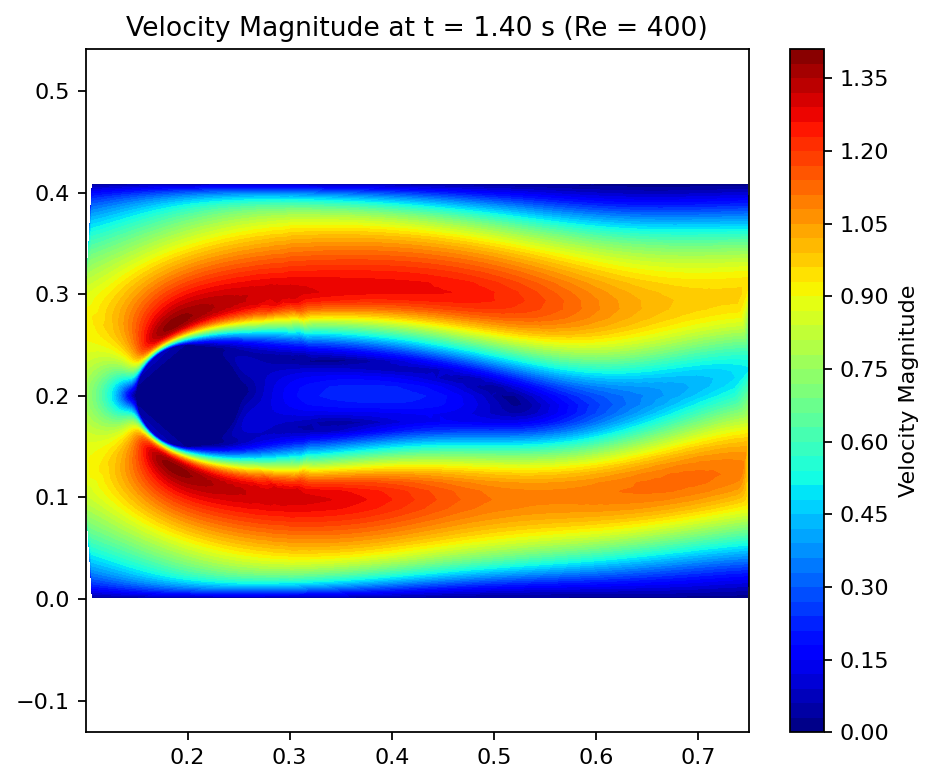

In [11]:

# Velocity Magnitude at Arbitrary Time for Re_input

# Parameters
Re_input = 400
t_target = 1.4  # Choose any time between 1.0 and 5.0 seconds

# Compute effective dt from sampled times
sampled_times_float = [float(t) for t in sampled_times]
dt_dmd = sampled_times_float[1] - sampled_times_float[0]

# Scale target time to DMD time index
scaled_t = (t_target - sampled_times_float[0]) / dt_dmd

# Get stabilized DMD components
Phi_stable, Lambda_stable, b_stable = stabilized_models[Re_input]

# Use mid-time reduced snapshot for richer dynamics
mid_index = len(sampled_times_float) // 2
coeffs_mid = reduced_snapshots[Re_input][:, mid_index]
coeffs_stable = np.linalg.pinv(Phi_stable) @ coeffs_mid

# Exponential time evolution
snapshot_reduced_t = Phi_stable @ (coeffs_stable * Lambda_stable ** scaled_t)
snapshot_reduced_t = np.real(snapshot_reduced_t)

# Reconstruct full snapshot using POD
snapshot_full_t = pod.inverse_transform(snapshot_reduced_t)

# Split into velocity components
ux = snapshot_full_t[:num_points]
uy = snapshot_full_t[num_points:]
velocity_magnitude = np.sqrt(ux**2 + uy**2)

# Plot velocity magnitude
coords = loader.vertices[mask.numpy(), :]
tri = mtri.Triangulation(coords[:, 0], coords[:, 1])
plt.figure(figsize=(6, 5))
plt.tricontourf(tri, velocity_magnitude, levels=50, cmap='jet')
plt.colorbar(label='Velocity Magnitude')
plt.title(f"Velocity Magnitude at t = {t_target:.2f} s (Re = {Re_input})")
plt.axis('equal')
plt.tight_layout()
plt.show()



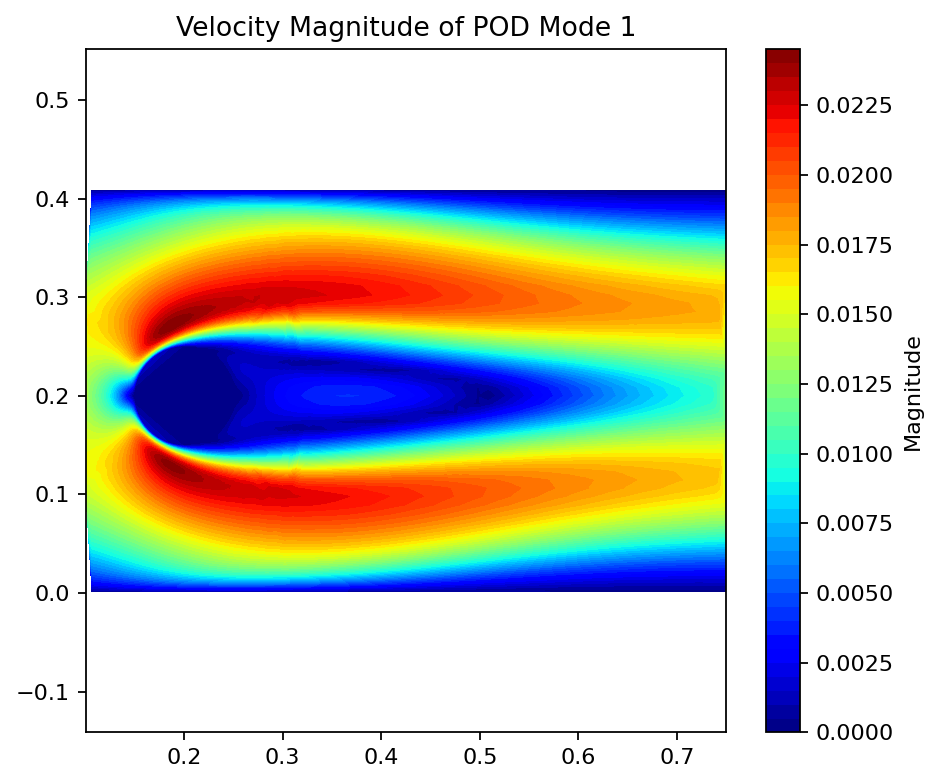

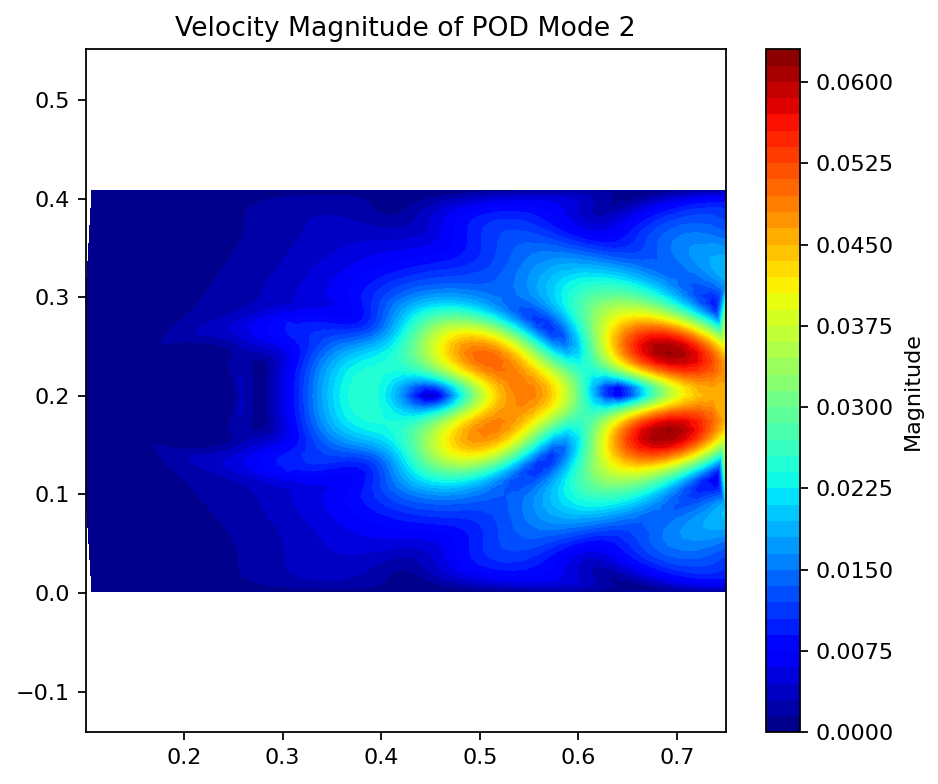

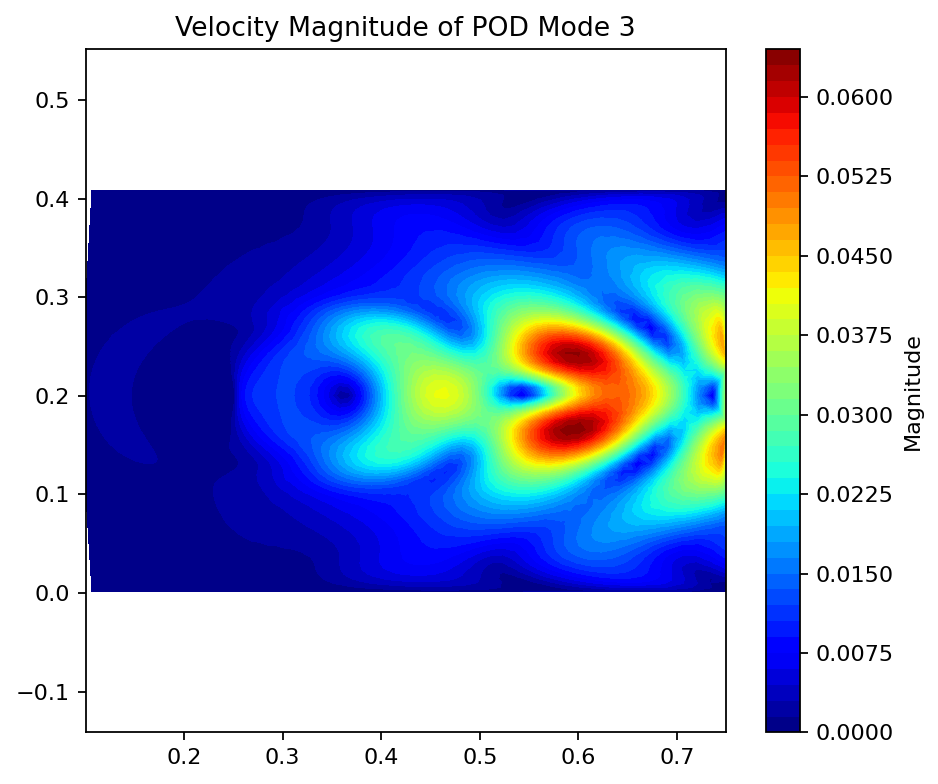

In [12]:
# Plot velocity magnitude from first 3 selected POD modes

mode_indices = [0, 1, 2]  # First three POD modes

# Get masked vertices (2D points)
coords = vertices[mask.numpy(), :]
tri = mtri.Triangulation(coords[:, 0], coords[:, 1])

for idx in mode_indices:
    mode = pod.modes[:, idx]
    ux_mode = mode[:num_points]
    uy_mode = mode[num_points:]
    velocity_magnitude = np.sqrt(ux_mode**2 + uy_mode**2)

    plt.figure(figsize=(6, 5))
    plt.tricontourf(tri, velocity_magnitude, levels=50, cmap='jet')
    plt.title(f"Velocity Magnitude of POD Mode {idx + 1}")
    plt.colorbar(label="Magnitude")
    plt.axis('equal')
    plt.tight_layout()
    plt.show()


# Online Phase: Forecasting & Interpolation for Unseen Re  

In [13]:
# Forecast future snapshots using each Re's stabilized model

# Define multiple Reynolds numbers for interpolation
Re_interpolation = [200, 300, 400, 500, 600, 700, 800]  # Modify this list as needed

# Forecast future reduced snapshots using partitioned stabilized DMD
# Extend forecast time range beyond training
forecast_times = [float(t) for t in sampled_times]
future_times = [5.2, 5.4, 5.6, 5.8, 6.0, 7.0, 8.0]  # Add future times here
forecast_times += future_times
t0 = forecast_times[0]
dt = forecast_times[1] - forecast_times[0]
normalized_times = [(t - t0) / dt for t in forecast_times]


forecasted_snapshots = {}

for Re_train in Re_list:
    # Retrieve stabilized DMD components
    Phi_stable, Lambda_stable, b_stable = stabilized_models[Re_train]

    # Use mid-time snapshot for richer dynamics
    mid_index = reduced_snapshots[Re_train].shape[1] // 2
    coeffs_mid = reduced_snapshots[Re_train][:, mid_index]
    coeffs_stable = np.linalg.pinv(Phi_stable) @ coeffs_mid

    # Forecast reduced snapshots over normalized times
    snapshots = []
    for tau in normalized_times:
        snapshot_t = np.real(Phi_stable @ (coeffs_stable * Lambda_stable ** tau))
        snapshots.append(snapshot_t)

    forecasted_snapshots[Re_train] = np.array(snapshots).T  # shape: (r, num_time_steps)

# Interpolate reduced snapshots across Re
interpolated_forecasts = {}

for Re_interp in Re_interpolation:
    interpolated_forecast = []

    for t_idx in range(len(normalized_times)):
        snapshots_at_t = np.array([forecasted_snapshots[Re_train][:, t_idx] for Re_train in Re_list])  # shape: (num_Re, r)

        rbf = RBF(kernel='gaussian', epsilon=1e-2)
        rbf.fit(np.array(Re_list).reshape(-1, 1), snapshots_at_t)
        pred = rbf.predict(np.array([[Re_interp]]))  # shape: (1, r)

        interpolated_forecast.append(pred[0])  # shape: (r,)

    interpolated_forecasts[Re_interp] = np.array(interpolated_forecast).T  # shape: (r, num_time_steps)

# Reconstruct full-field snapshots using POD
reconstructed_snapshots = {}

for Re_interp, forecasted_coeffs in interpolated_forecasts.items():
    reconstructed = pod.inverse_transform(forecasted_coeffs)
    reconstructed_snapshots[Re_interp] = reconstructed

print(f"Reconstructed snapshots available for Re values: {Re_interpolation}")


Reconstructed snapshots available for Re values: [200, 300, 400, 500, 600, 700, 800]


## Visualize true vs reconstructed velocity magnitude for the "input parameters"

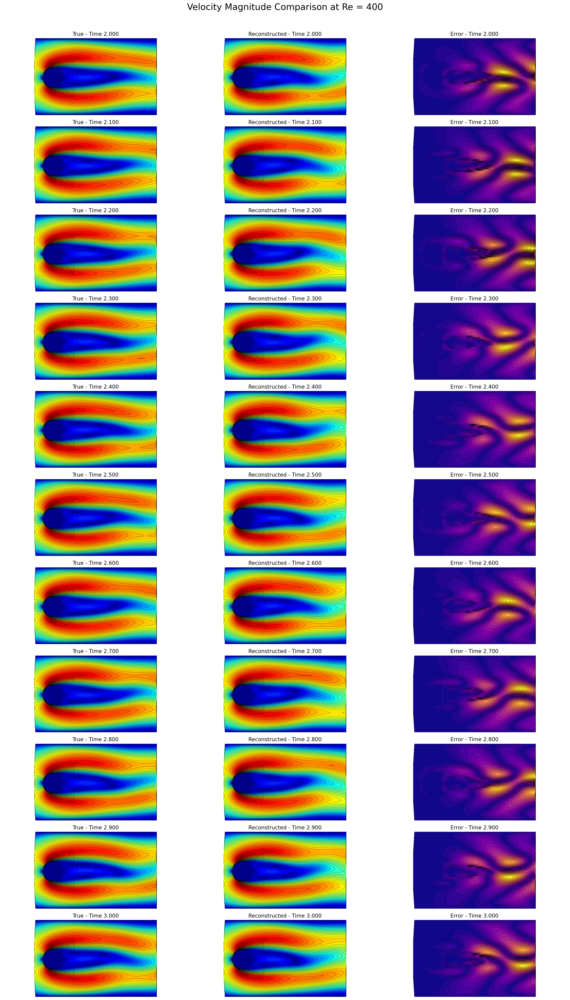

In [14]:
# Visualize true vs reconstructed velocity magnitude for the input parameters

# Parameters to control time range and sampling
t_start = 2.0
t_end = 3.0
granularity = 10  # Use every nth snapshot in the range

# Reynolds number to visualize (must be in Re_list)
Re_true_solution = 400  # Change this to any value from Re_list

# Safety check: Only visualize if Re_true_solution is in training data
if Re_true_solution not in Re_list:
    print(f"⚠️ Cannot plot: No true data available for Re_true_solution = {Re_true_solution}. Skipping visualization.")
else:
    num_points = mask.sum().item()

    # Convert sampled_times to float for comparison
    sampled_times_float = [float(t) for t in sampled_times]

    # Filter time indices based on user input
    time_indices = [i for i, t in enumerate(sampled_times_float) if t_start <= t <= t_end][::granularity]
    time_labels = [sampled_times_float[i] for i in time_indices]

    if not time_indices:
        print(f"⚠️ No time frames found in range [{t_start}, {t_end}] with granularity {granularity}.")
    else:
        # Slice velocity components
        u_x_rec = reconstructed_snapshots[Re_true_solution][:num_points, :][:, time_indices]
        u_y_rec = reconstructed_snapshots[Re_true_solution][num_points:, :][:, time_indices]

        u_x_true = snapshot_dict[Re_true_solution][:num_points, :][:, time_indices]
        u_y_true = snapshot_dict[Re_true_solution][num_points:, :][:, time_indices]

        coords = loader.vertices[:, :2][mask.numpy()]
        num_frames = len(time_labels)

        fig, axes = plt.subplots(num_frames, 3, figsize=(18, 3 * num_frames))
        fig.suptitle(f"Velocity Magnitude Comparison at Re = {Re_true_solution}", fontsize=20)

        for i in range(num_frames):
            mag_true = np.sqrt(u_x_true[:, i]**2 + u_y_true[:, i]**2)
            mag_rec = np.sqrt(u_x_rec[:, i]**2 + u_y_rec[:, i]**2)
            mag_err = np.abs(mag_true - mag_rec)

            for ax, data, title, cmap in zip(axes[i], [mag_true, mag_rec, mag_err],
                                             ["True", "Reconstructed", "Error"],
                                             ["jet", "jet", "plasma"]):
                ax.tricontourf(coords[:, 0], coords[:, 1], data, levels=50, cmap=cmap)
                ax.tricontour(coords[:, 0], coords[:, 1], data, levels=30, linewidths=0.3, colors='k')
                ax.set_title(f"{title} - Time {time_labels[i]:.3f}")
                ax.axis('equal')
                ax.axis('off')

        plt.tight_layout(rect=[0, 0.03, 1, 0.97])
        plt.show()



## Visualize true vs reconstructed velocity magnitude for the "unseen parameters"

In [15]:
# Define path and loader
Re_target = 500
path = "/home/haseeb/OpenFOAM/run/cylinder_2D_Re500"
loader = FOAMDataloader(path)
times = loader.write_times

# Sampling step for downsampling the snapshots
sampling_step = 5  # adjust this value as needed

# Filter and downsample time steps
window_times = [t for t in times if 1.0 <= float(t) <= 5.0]
sampled_times = window_times[::sampling_step]

# Create mask for cylinder region
vertices = loader.vertices[:, :2]
mask = mask_box(vertices, lower=[0.1, -1], upper=[0.75, 1])

# Load masked velocity snapshots
masked_data_matrix, num_points = load_masked_matrix(loader, mask, sampled_times)

# Store in snapshot_dict
snapshot_dict[Re_target] = masked_data_matrix

# Confirm shape
print(f"Loaded true snapshots for Re={Re_target}: {masked_data_matrix.shape}")

INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor0/constant
INFO:flowtorch.data.foam_dataloader:Loading precomputed cell centers and volumes from processor1/constant


Loaded true snapshots for Re=500: (11492, 401)


In [16]:
for Re_interp in reconstructed_snapshots:
    # Get number of forecast steps for this interpolated Re
    num_forecast_steps = reconstructed_snapshots[Re_interp].shape[1]

    # Trim the sampled_times from the END to match forecast horizon
    aligned_sampled_times = sampled_times[-num_forecast_steps:]

    # Reload true snapshots corresponding to aligned times
    masked_data_matrix, _ = load_masked_matrix(loader, mask, aligned_sampled_times)

    # Update snapshot_dict with true data for this Re
    snapshot_dict[Re_interp] = masked_data_matrix

    # Confirm match
    print(f"Re={Re_interp}")
    print(f"  True snapshots shape: {masked_data_matrix.shape}")
    print(f"  Reconstructed snapshots shape: {reconstructed_snapshots[Re_interp].shape}")
    print(f"  Aligned time labels: {aligned_sampled_times}")



Re=200
  True snapshots shape: (11492, 401)
  Reconstructed snapshots shape: (11492, 408)
  Aligned time labels: ['1', '1.01', '1.02', '1.03', '1.04', '1.05', '1.06', '1.07', '1.08', '1.09', '1.1', '1.11', '1.12', '1.13', '1.14', '1.15', '1.16', '1.17', '1.18', '1.19', '1.2', '1.21', '1.22', '1.23', '1.24', '1.25', '1.26', '1.27', '1.28', '1.29', '1.3', '1.31', '1.32', '1.33', '1.34', '1.35', '1.36', '1.37', '1.38', '1.39', '1.4', '1.41', '1.42', '1.43', '1.44', '1.45', '1.46', '1.47', '1.48', '1.49', '1.5', '1.51', '1.52', '1.53', '1.54', '1.55', '1.56', '1.57', '1.58', '1.59', '1.6', '1.61', '1.62', '1.63', '1.64', '1.65', '1.66', '1.67', '1.68', '1.69', '1.7', '1.71', '1.72', '1.73', '1.74', '1.75', '1.76', '1.77', '1.78', '1.79', '1.8', '1.81', '1.82', '1.83', '1.84', '1.85', '1.86', '1.87', '1.88', '1.89', '1.9', '1.91', '1.92', '1.93', '1.94', '1.95', '1.96', '1.97', '1.98', '1.99', '2', '2.01', '2.02', '2.03', '2.04', '2.05', '2.06', '2.07', '2.08', '2.09', '2.1', '2.11', '2.12'

In [17]:
def plot_velocity_comparison(Re_target, reconstructed_snapshots_dict, masked_data_matrix, mask, loader, sampled_times, t_start_vis, t_end_vis, granularity=1):
    num_points = mask.sum().item()

    # Extract the snapshot array for the given Reynolds number
    reconstructed_snapshots = reconstructed_snapshots_dict[Re_target]

    # Filter time indices based on user input
    sampled_times_float = [float(t) for t in sampled_times]
    time_indices = [i for i, t in enumerate(sampled_times_float) if t_start_vis <= t <= t_end_vis][::granularity]
    time_labels = [sampled_times_float[i] for i in time_indices]

    # Slice velocity components
    u_x_rec = reconstructed_snapshots[:num_points, :][:, time_indices]
    u_y_rec = reconstructed_snapshots[num_points:, :][:, time_indices]

    u_x_true = masked_data_matrix[:num_points, :][:, time_indices]
    u_y_true = masked_data_matrix[num_points:, :][:, time_indices]

    # Coordinates for plotting
    coords = loader.vertices[:, :2][mask.numpy()]
    num_frames = len(time_labels)

    fig, axes = plt.subplots(num_frames, 3, figsize=(18, 3 * num_frames))
    fig.suptitle(f"Velocity Magnitude Comparison at Re = {Re_target}", fontsize=20)

    for i in range(num_frames):
        mag_true = np.sqrt(u_x_true[:, i]**2 + u_y_true[:, i]**2)
        mag_rec = np.sqrt(u_x_rec[:, i]**2 + u_y_rec[:, i]**2)
        mag_err = np.abs(mag_true - mag_rec)

        for ax, data, title, cmap in zip(axes[i], [mag_true, mag_rec, mag_err],
                                         ["True", "Reconstructed", "Error"],
                                         ["jet", "jet", "plasma"]):
            ax.tricontourf(coords[:, 0], coords[:, 1], data, levels=50, cmap=cmap)
            ax.tricontour(coords[:, 0], coords[:, 1], data, levels=30, linewidths=0.3, colors='k')
            ax.set_title(f"{title} - Time {time_labels[i]:.3f}")
            ax.axis('equal')
            ax.axis('off')

    plt.tight_layout(rect=[0, 0.03, 1, 0.97])
    plt.show()



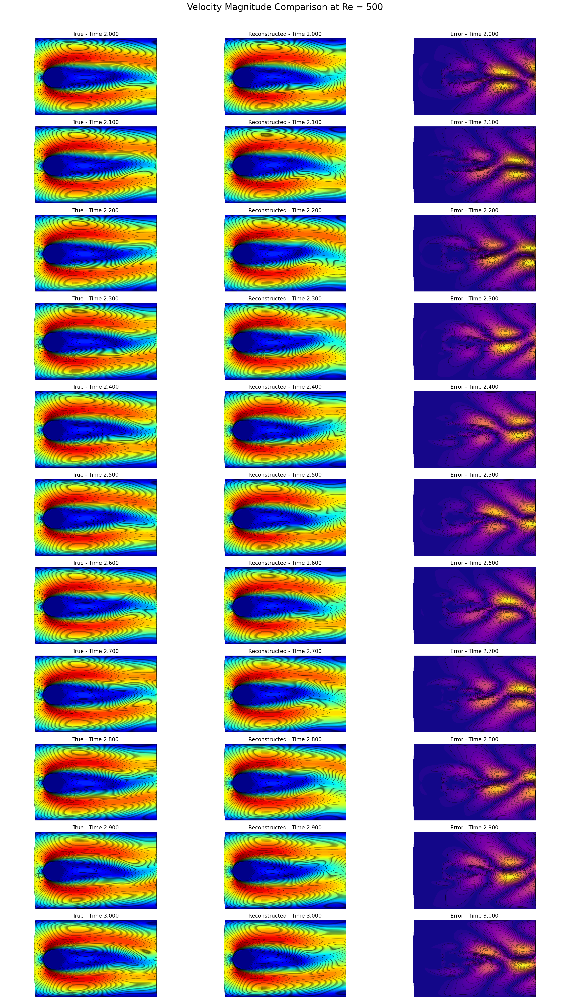

In [18]:
# Select the plot window

# Automatically choose ground truth: seen vs unseen
ground_truth_matrix = snapshot_dict.get(Re_target, masked_data_matrix)

# Plot comparison
plot_velocity_comparison(
    Re_target,
    reconstructed_snapshots,
    ground_truth_matrix,
    mask,
    loader,
    sampled_times,
    t_start_vis=2.0,
    t_end_vis=3.0,
    granularity=10
)


## Velocity contours at unseen time 

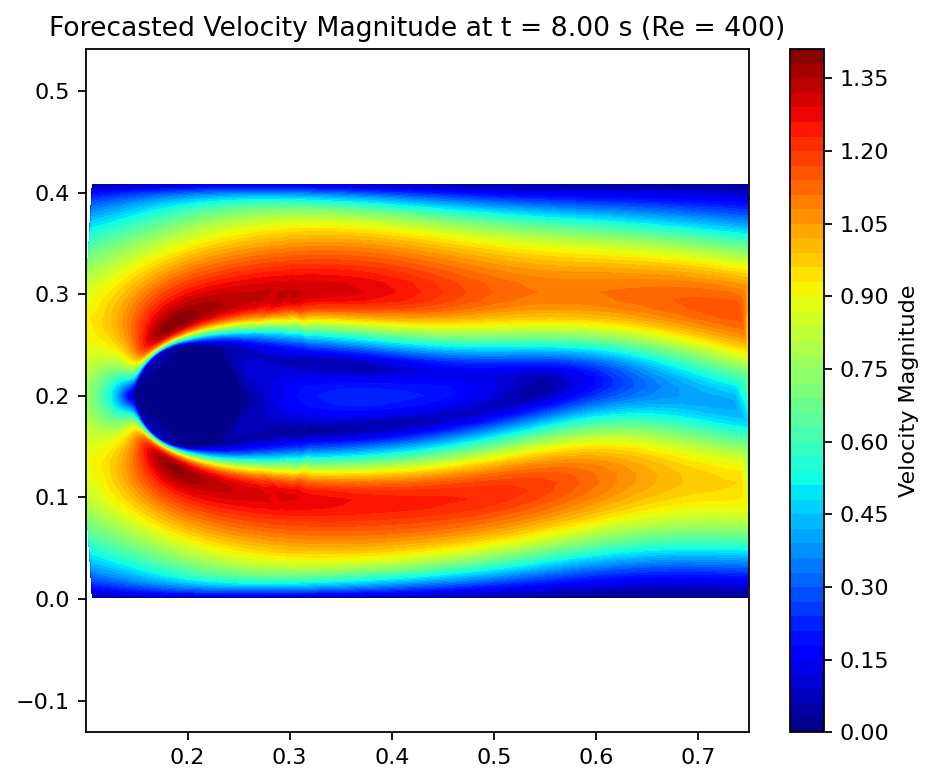

In [19]:
# Forecast and visualize at future time
Re_input = 400
t_target = 8  # Future time

# Compute effective dt
sampled_times_float = [float(t) for t in sampled_times]
dt_dmd = sampled_times_float[1] - sampled_times_float[0]
scaled_t = (t_target - sampled_times_float[0]) / dt_dmd

# Get stabilized DMD components
Phi_stable, Lambda_stable, b_stable = stabilized_models[Re_input]

# Use mid-time reduced snapshot
mid_index = len(sampled_times_float) // 2
coeffs_mid = reduced_snapshots[Re_input][:, mid_index]
coeffs_stable = np.linalg.pinv(Phi_stable) @ coeffs_mid

# Forecast reduced snapshot
snapshot_reduced_t = Phi_stable @ (coeffs_stable * Lambda_stable ** scaled_t)
snapshot_full_t = pod.inverse_transform(np.real(snapshot_reduced_t))

# Split and plot
ux = snapshot_full_t[:num_points]
uy = snapshot_full_t[num_points:]
velocity_magnitude = np.sqrt(ux**2 + uy**2)

coords = loader.vertices[mask.numpy(), :]
tri = mtri.Triangulation(coords[:, 0], coords[:, 1])
plt.figure(figsize=(6, 5))
plt.tricontourf(tri, velocity_magnitude, levels=50, cmap='jet')
plt.colorbar(label='Velocity Magnitude')
plt.title(f"Forecasted Velocity Magnitude at t = {t_target:.2f} s (Re = {Re_input})")
plt.axis('equal')
plt.tight_layout()
plt.show()
